# Activation Visualization Experiments



In [ ]:
!pip install torch torchvision timm matplotlib pandas seaborn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 52.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 38.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 49.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 48.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
import torch
import torch.nn as nn
from torchvision import datasets, transforms
from torchvision.models import resnet18
from torch.utils.data import DataLoader, Subset
import timm
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import numpy as np
import random
from tqdm import tqdm
import seaborn as sns
import pandas as pd

In [ ]:
def seed_everything(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

seed_everything()


In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cpu


In [ ]:
activation_dict = {}
hooks = []
NFEX = 30
random_indices = {}

def get_hook(name):
    def hook(module, input, output):
        # The output from a ResNet layer is a 4D tensor: (batch_size, channels, height, width).
        # We convert this feature map into a single vector per image using global average pooling.
        # This results in a tensor of shape (batch_size, channels).
        pooled_output = torch.mean(output, dim=[2, 3])
        activations = pooled_output.detach().cpu().numpy()

        if name not in random_indices:
            num_channels = activations.shape[1]
            k = min(NFEX, num_channels)
            random_indices["x"] = np.random.choice(num_channels, size=k, replace=False)
        indices_to_extract = random_indices["x"]

        for i in range(activations.shape[0]):
            activation_dict[name]["tmp"].append(activations[i, indices_to_extract])
    return hook

In [ ]:
model = resnet18(pretrained=True)
model.fc = nn.Linear(model.fc.in_features, 10)
model.eval()
for param in model.parameters():
    param.requires_grad = False

for idx, layer in enumerate([model.layer1, model.layer2, model.layer3, model.layer4]):
    name = f"layer_{idx+1}"
    activation_dict[name] = {"tmp": []}
    hooks.append(layer.register_forward_hook(get_hook(name)))

model = model.to(device)

In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

cifar = datasets.CIFAR10(root="./data", train=False, transform=transform, download=True)
svhn = datasets.SVHN(root="./data", split='test', transform=transform, download=True)

cifar_loader = DataLoader(Subset(cifar, range(1000)), batch_size=32, shuffle=False)
svhn_loader = DataLoader(Subset(svhn, range(1000)), batch_size=32, shuffle=False)


In [ ]:
def extract_features(dataloader):
    for key in activation_dict:
        for i in range(NFEX):
            activation_dict[key][i] = [] # samples x features

    for images, targets in tqdm(dataloader, desc=f"Processing"):
        with torch.no_grad():
            activations = model(images.to(device))

        for key in activation_dict:
            for i in range(images.shape[0]):
                activation_dict[key][targets[i].item()].append(activation_dict[key]["tmp"][i])
        activation_dict[key]["tmp"] = []

    data = []
    for key in activation_dict:
        for cls, features in activation_dict[key].items():
            if cls == "tmp":
                continue
            features_array = np.array(features).T
            for feature in range(features_array.shape[0]):
                data.append({
                    'block': key,
                    'class': cls,
                    'feature': feature,
                    'activations': features_array[feature].copy() # samples
                })

    return pd.DataFrame.from_dict(data)

In [ ]:
print("CIFAR-10")
cifar_df = extract_features(cifar_loader)
print("SVHN")
svhn_df = extract_features(svhn_loader)


CIFAR-10


Processing: 100%|██████████| 32/32 [01:21<00:00,  2.54s/it]


SVHN


Processing: 100%|██████████| 32/32 [01:21<00:00,  2.56s/it]


In [19]:
def visualize_kde(df, dataset_name):
    for block_name, block_df in df.groupby('block'):
        features = block_df['feature'].unique()
        for feat in features:
            plt.figure(figsize=(8, 5))
            sub_df = block_df[block_df['feature'] == feat]
            exploded_df = sub_df.copy()
            exploded_df = exploded_df.explode('activations')
            sns.kdeplot(data=exploded_df, x='activations', hue='class', fill=True, common_norm=False, alpha=0.4)
            plt.title(f"{dataset_name} - {block_name} - feature: {feat} (KDE)")
            plt.xlabel("Activation Value")
            plt.ylabel("Density")
            plt.tight_layout()
            plt.show()

In [20]:
def visualize_2d(df, dataset_name):
    palette = sns.color_palette("tab10")
    sorted_blocks = sorted(df['block'].unique(), key=lambda x: int(x.split('_')[1]))

    for block_name in sorted_blocks:
        block_df = df[df['block'] == block_name]
        dist_df = block_df.copy()
        dist_df['feature_idx'] = dist_df['feature']
        dist_df = dist_df.explode('activations')
        dist_df['activations'] = dist_df['activations'].astype(float)

        plt.figure(figsize=(10, 6))
        legend_elements = []

        for i, cls in enumerate(sorted(dist_df['class'].unique())):
            cls_df = dist_df[dist_df['class'] == cls]

            sns.histplot(
                data=cls_df,
                x='feature_idx',
                y='activations',
                fill=True,
                cmap=sns.light_palette(palette[i], as_cmap=True),
                alpha=0.6
            )

            legend_elements.append(Patch(facecolor=palette[i], label=str(cls)))

        plt.title(f"{dataset_name} - {block_name}")
        plt.xlabel("Feature Index")
        plt.ylabel("Activation Value")
        plt.legend(handles=legend_elements, title='Class')
        plt.tight_layout()
        plt.show()

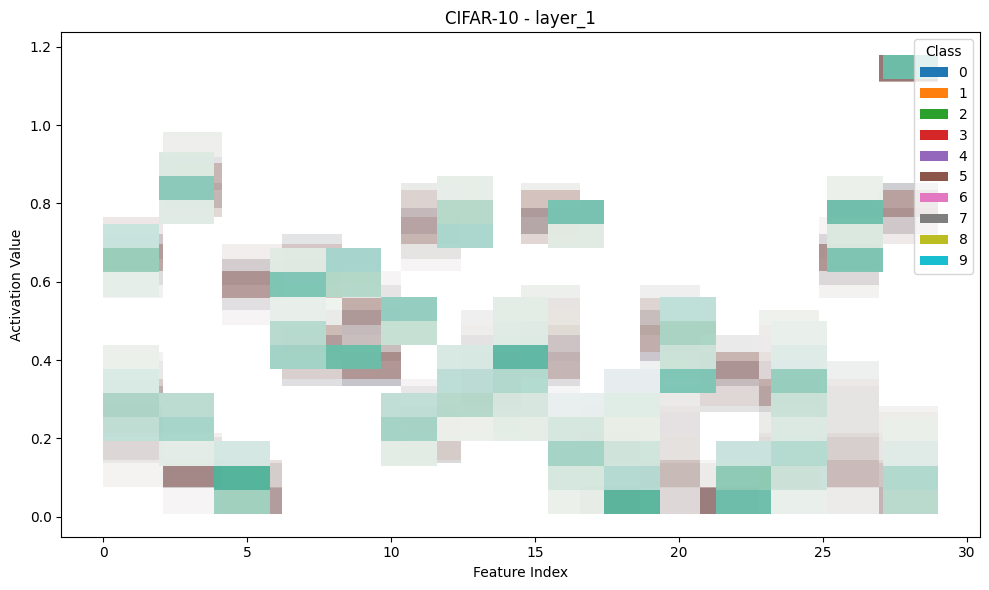

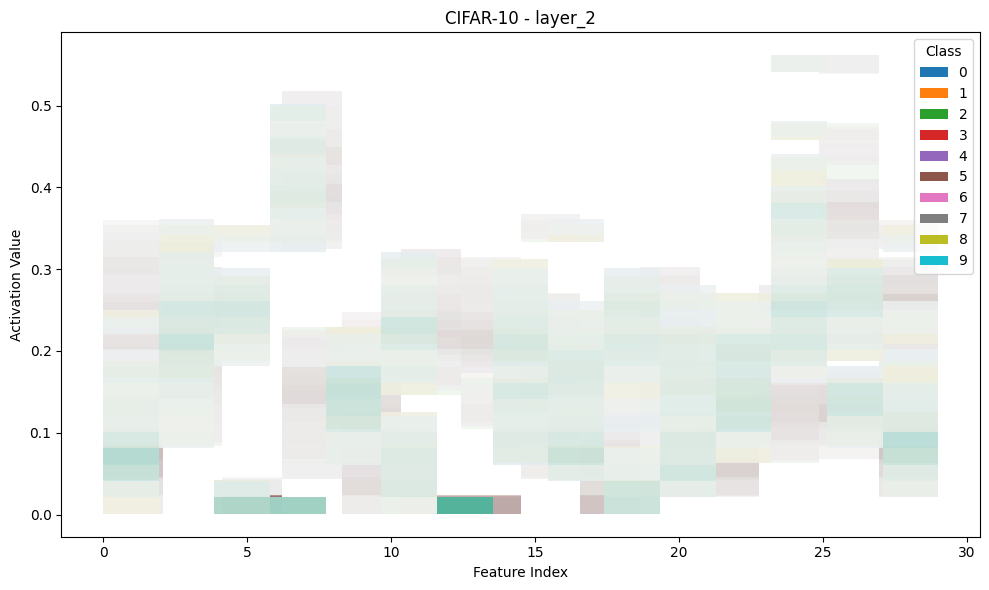

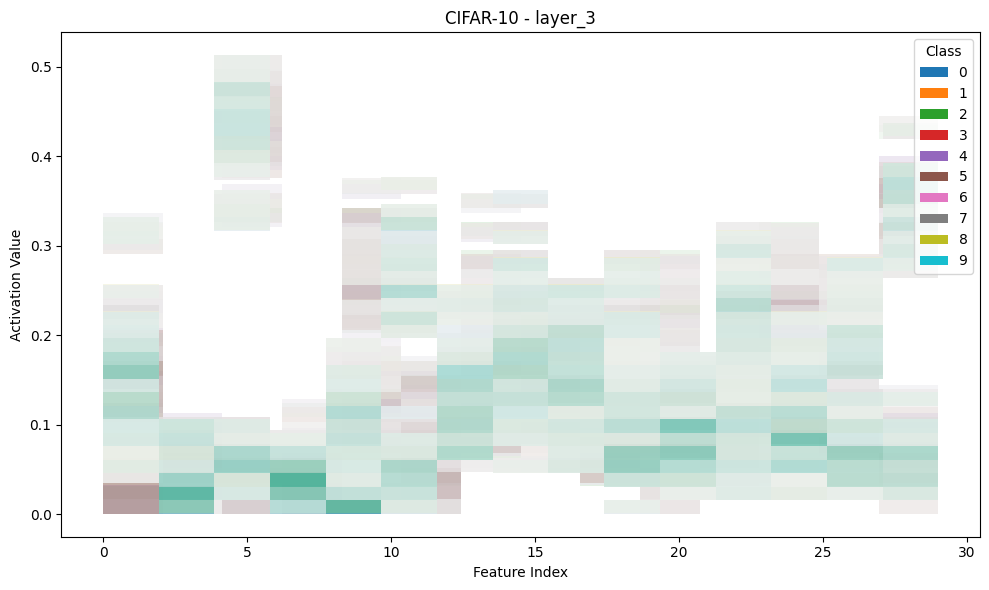

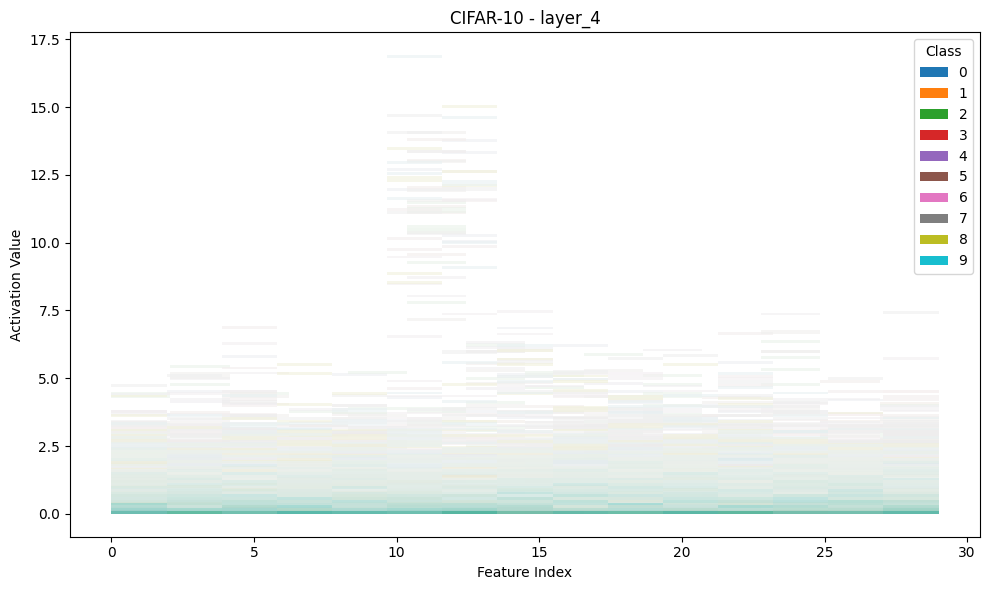

In [21]:
visualize_2d(cifar_df, "CIFAR-10")

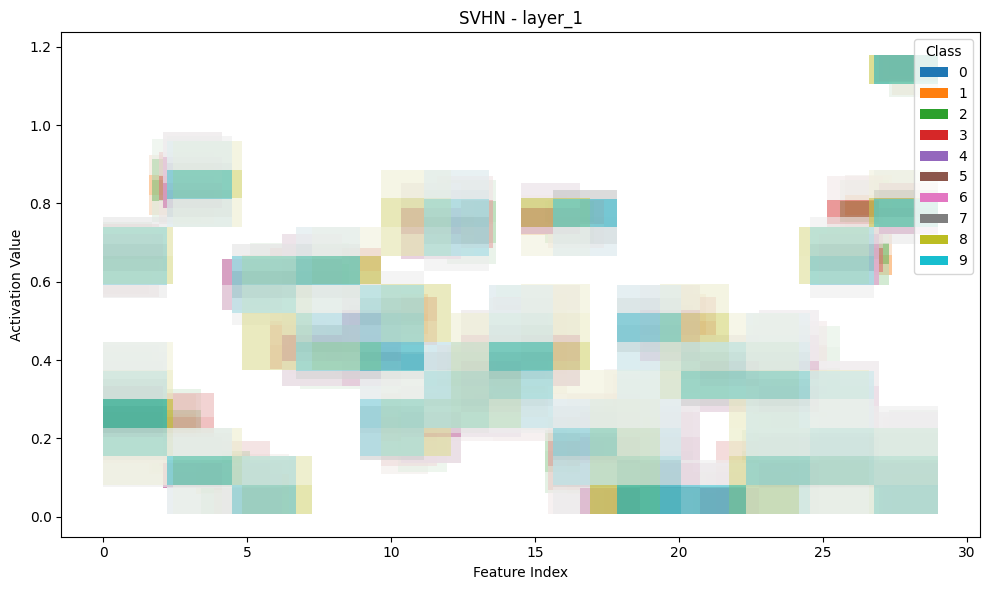

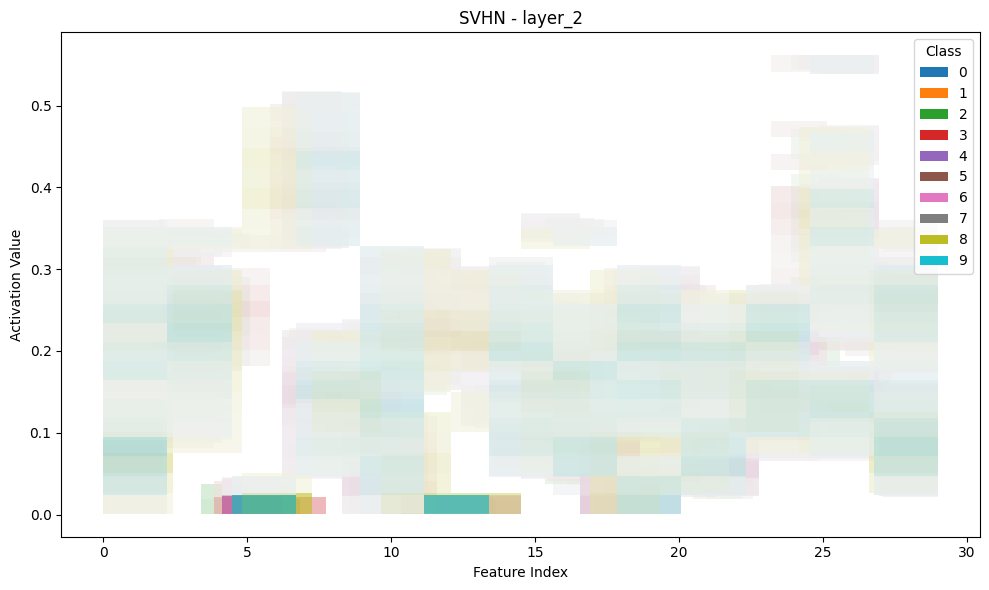

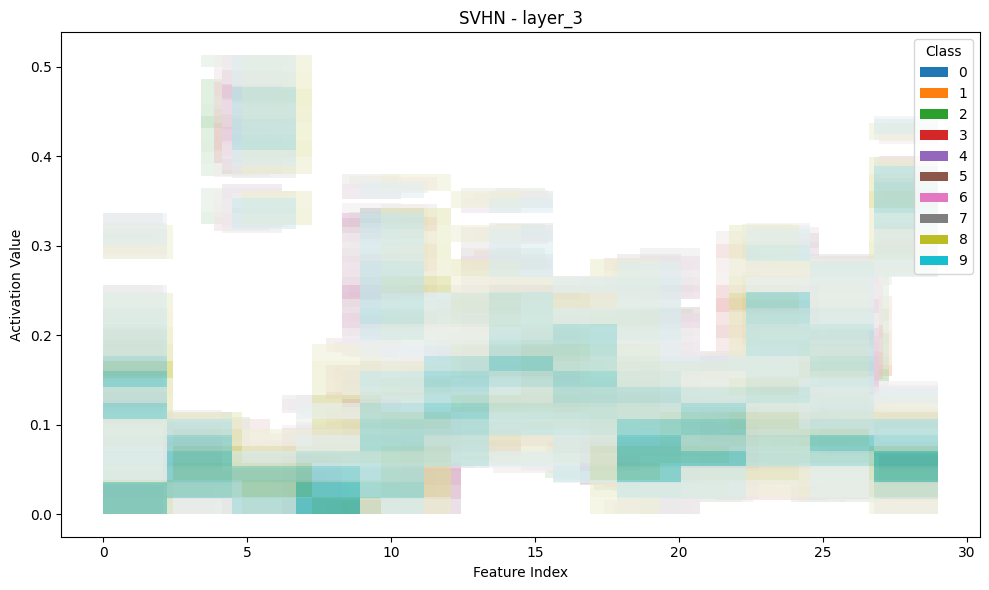

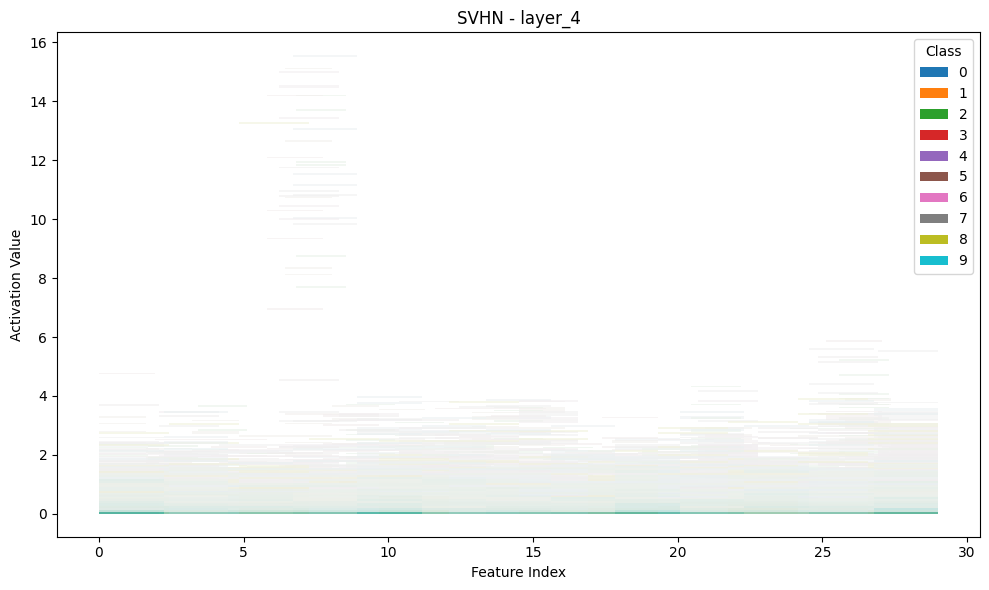

In [22]:
visualize_2d(svhn_df, "SVHN")

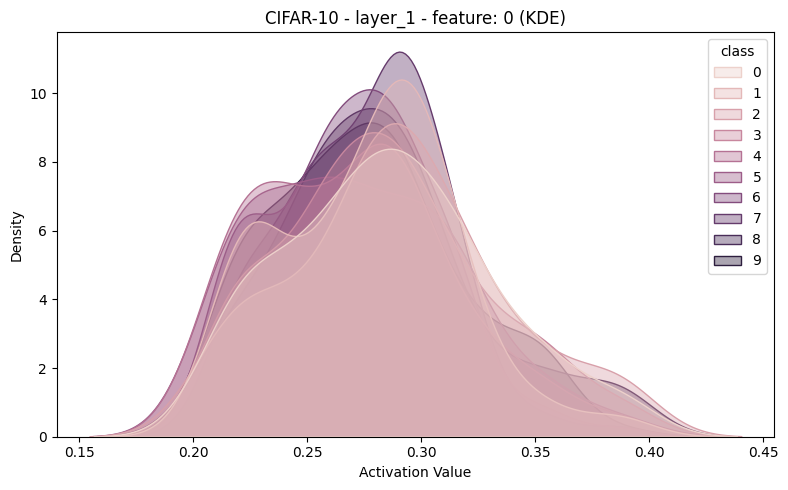

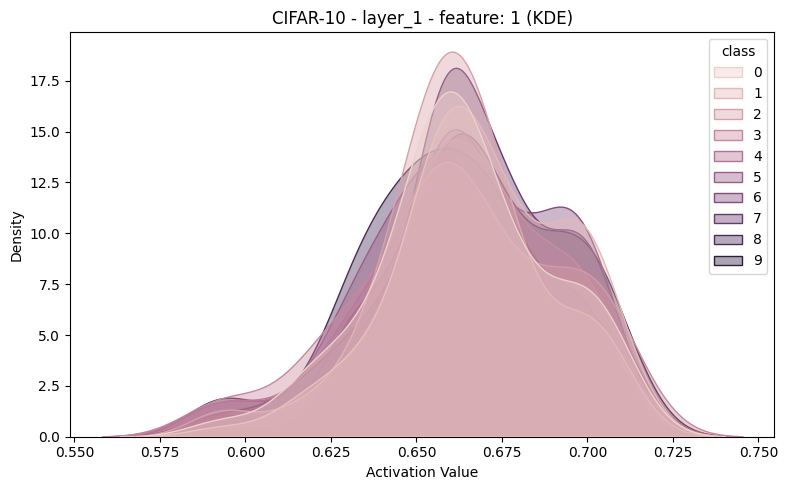

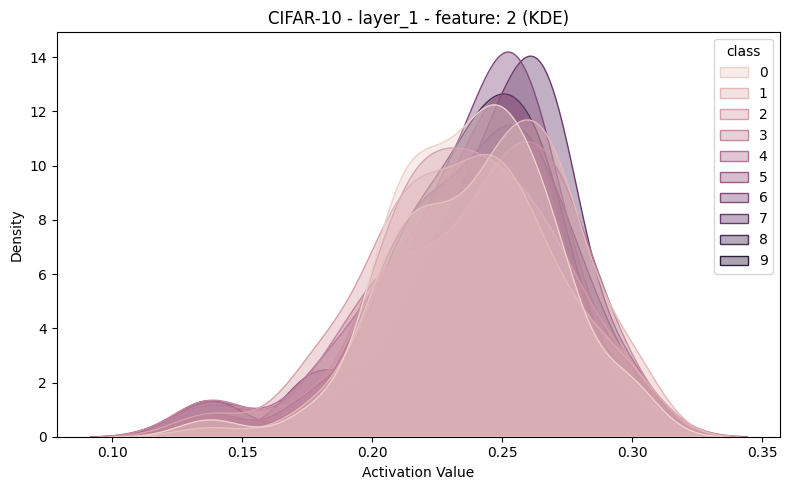

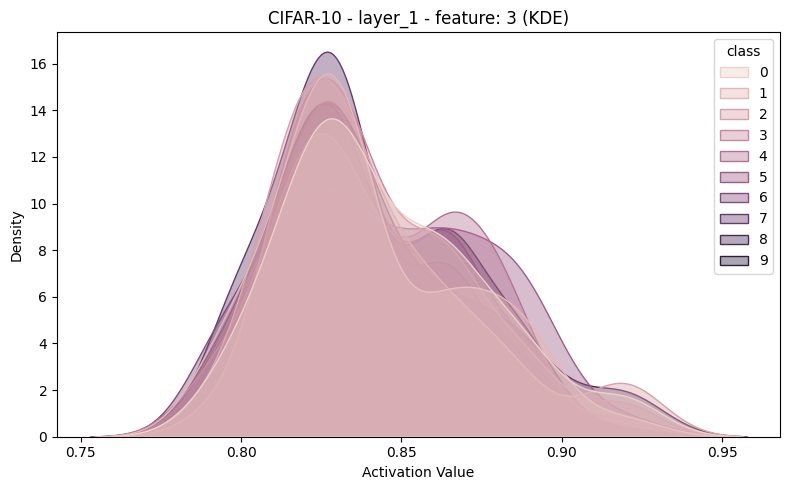

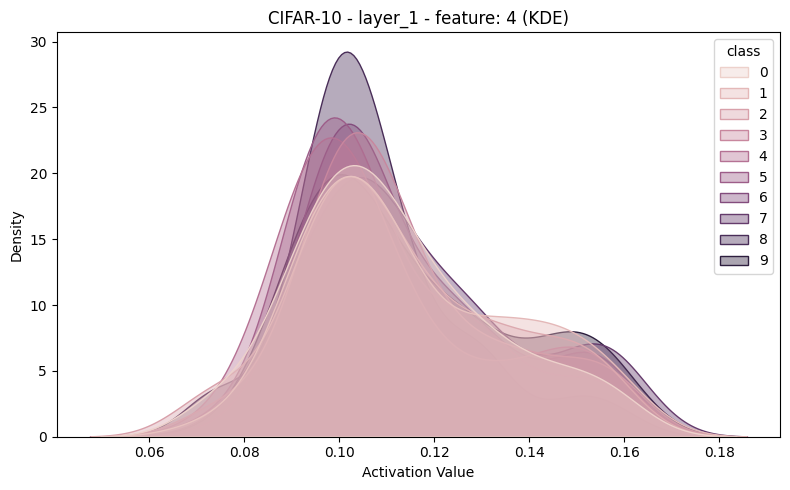

...

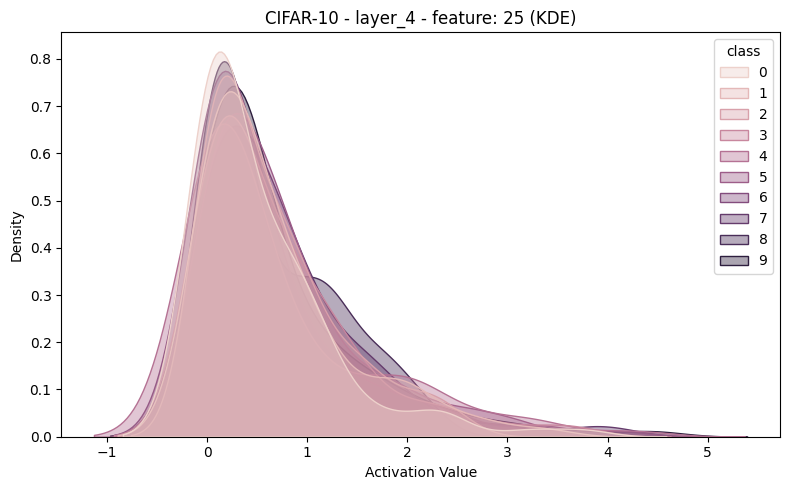

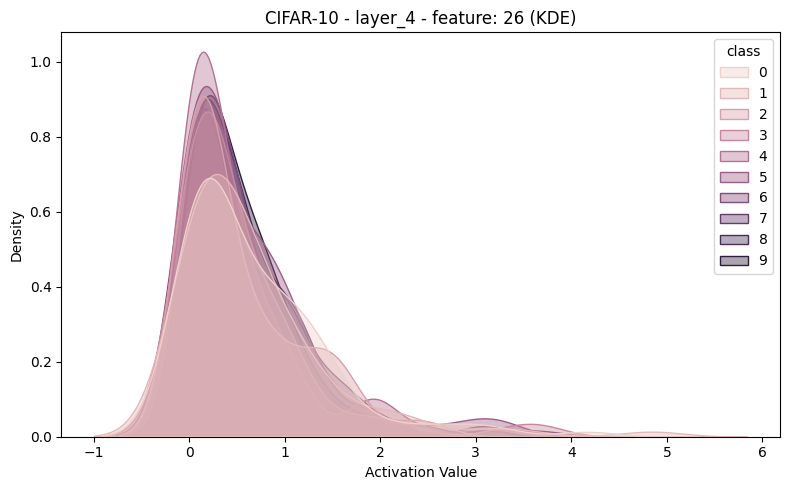

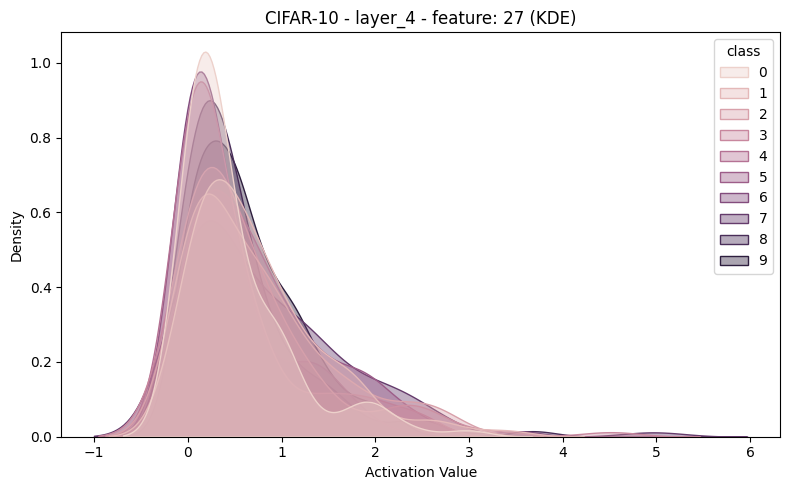

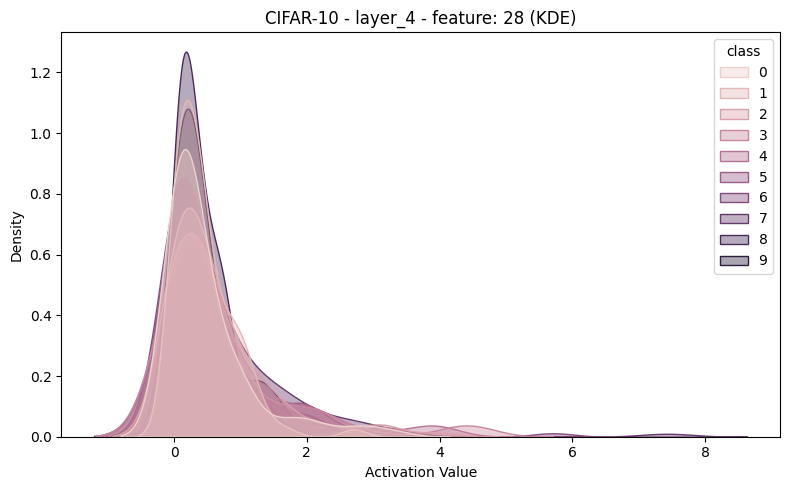

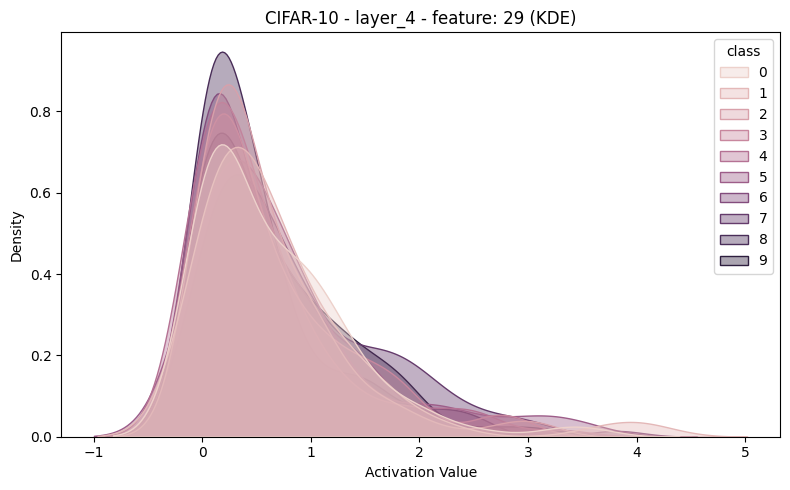

In [23]:
visualize_kde(cifar_df, "CIFAR-10")

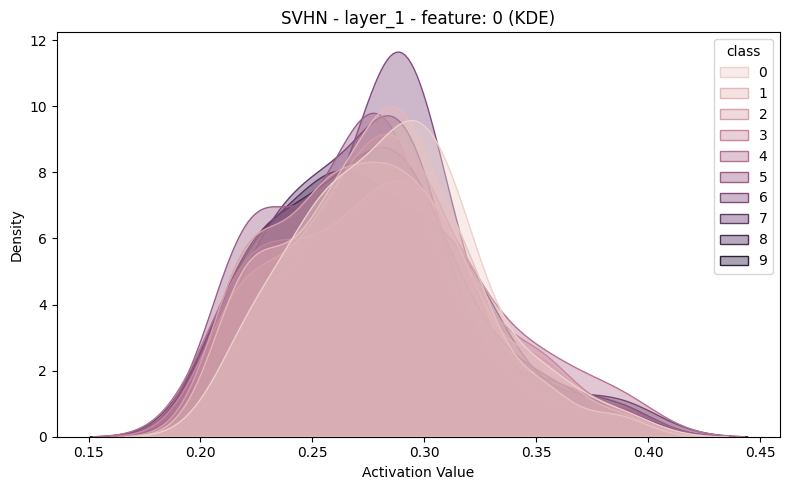

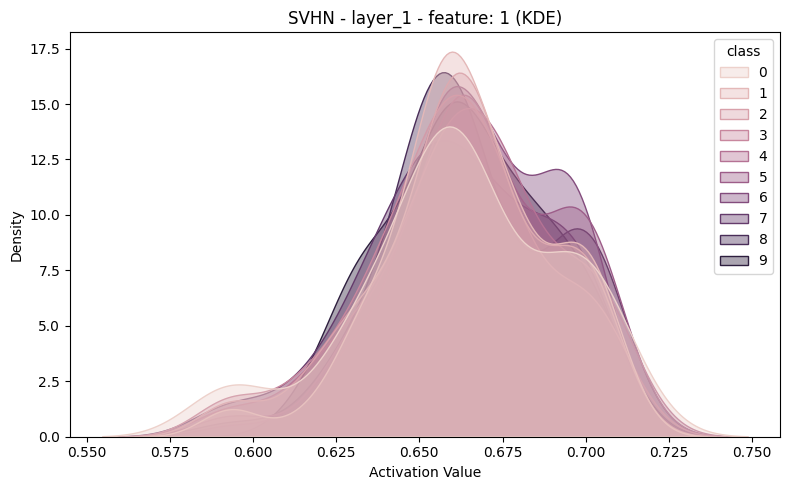

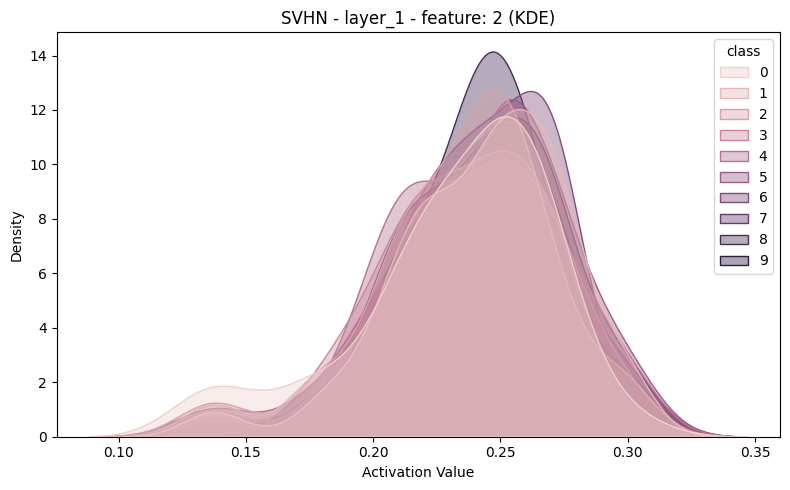

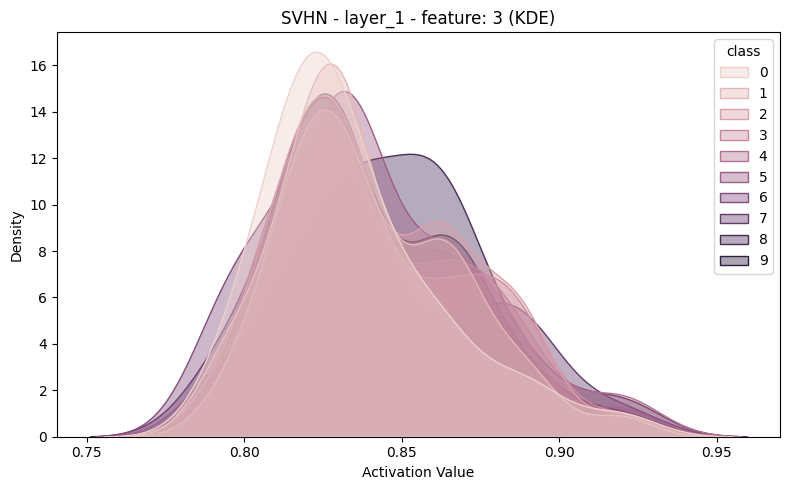

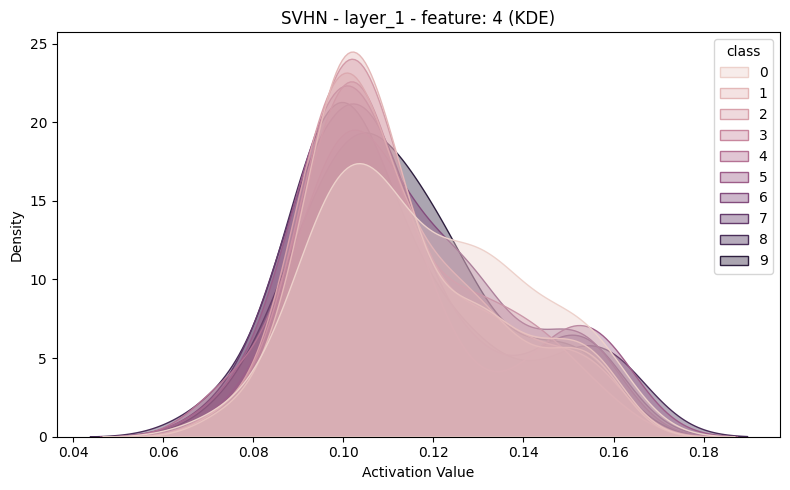

...

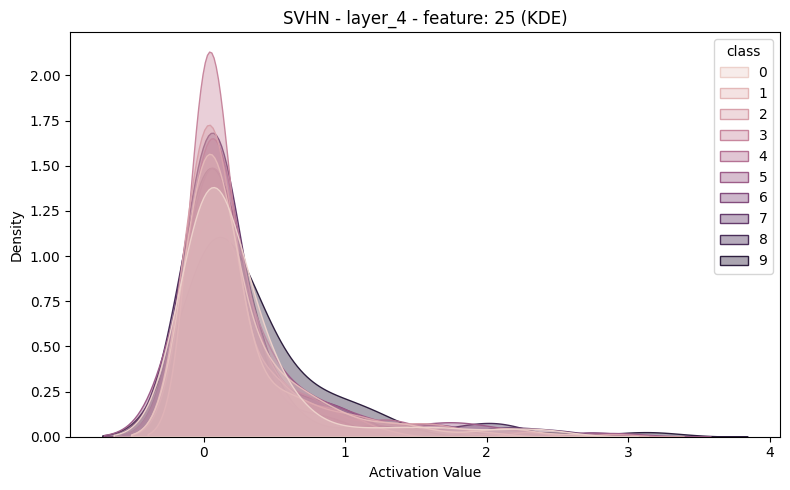

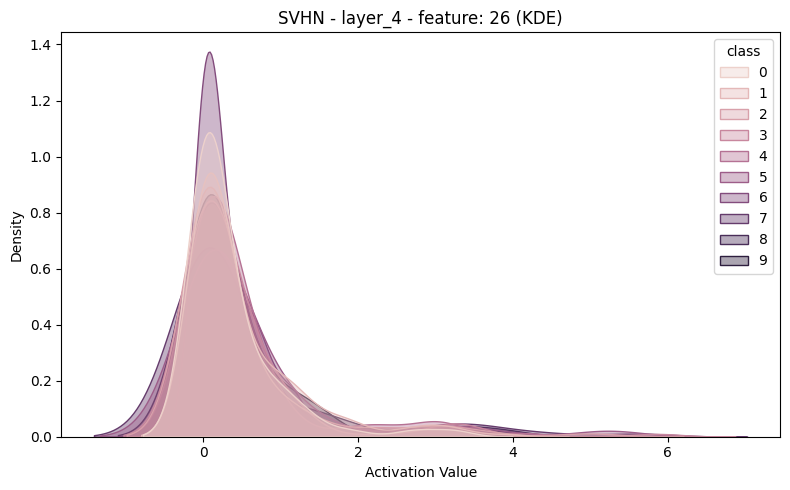

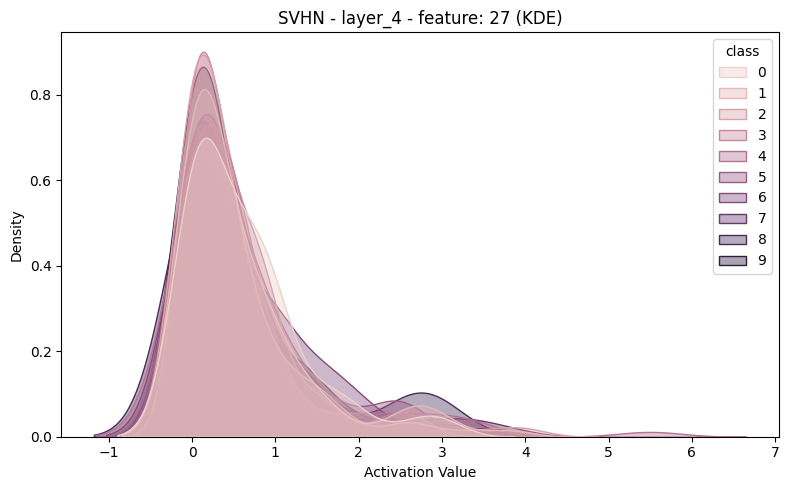

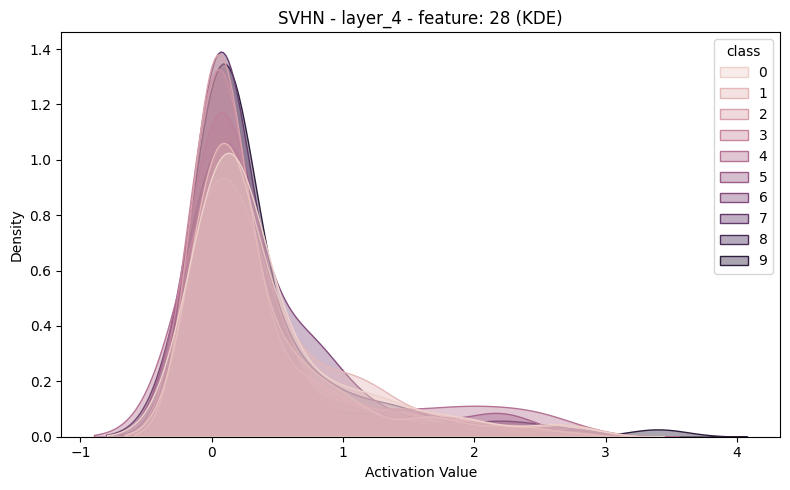

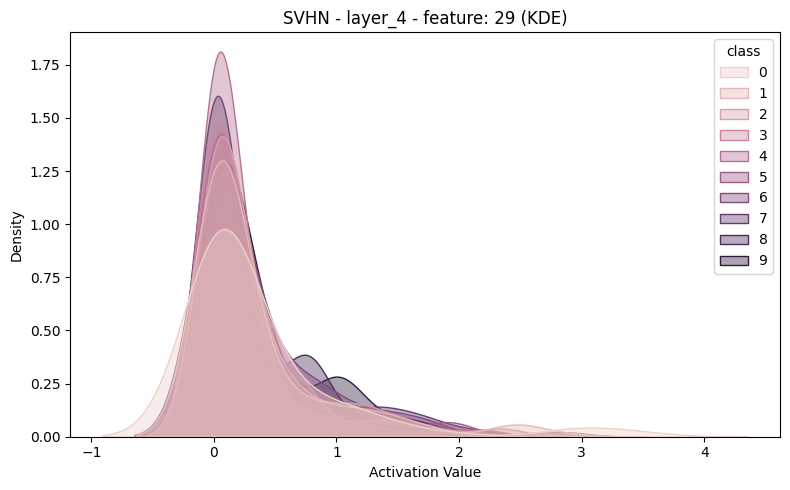

In [24]:
visualize_kde(svhn_df, "SVHN")